In [1]:
%cd '../..'
%pwd

/home/arslan/PycharmProjects/pr


/home/arslan/.cache/pypoetry/virtualenvs/pr-1TEpFMsl-py3.11/lib/python3.11/site-packages/IPython/core/magics/osm.py:417: UserWarning: using dhist requires you to install the `pickleshare` library.
  self.shell.db['dhist'] = compress_dhist(dhist)[-100:]


'/home/arslan/PycharmProjects/pr'

In [2]:
import random
import warnings
from typing import Callable

import albumentations as album
import cv2
import imutils
import numpy as np
import segmentation_models_pytorch.utils as smp_utils
from torch.utils.data import DataLoader
from torchinfo import summary

from azulvision.board_extraction.config import *
from azulvision.board_extraction.dataset import BEDataset
from azulvision.board_extraction.extract import extract_perspective, fix_mask, ignore_contours, rotate_quadrangle
from azulvision.board_extraction.model import UNet
from azulvision.board_extraction.one_hot import color_code_segmentation, reverse_one_hot
from azulvision.utils import visualize

%matplotlib inline
warnings.filterwarnings("ignore")

In [3]:
print('All dataset classes and their corresponding RGB values in labels:')
print('Class Names: ', CLASS_NAMES)
print('Class RGB values: ', CLASS_RGB_VALUES)

All dataset classes and their corresponding RGB values in labels:
Class Names:  ['background', 'board']
Class RGB values:  [[0, 0, 0], [128, 0, 0]]


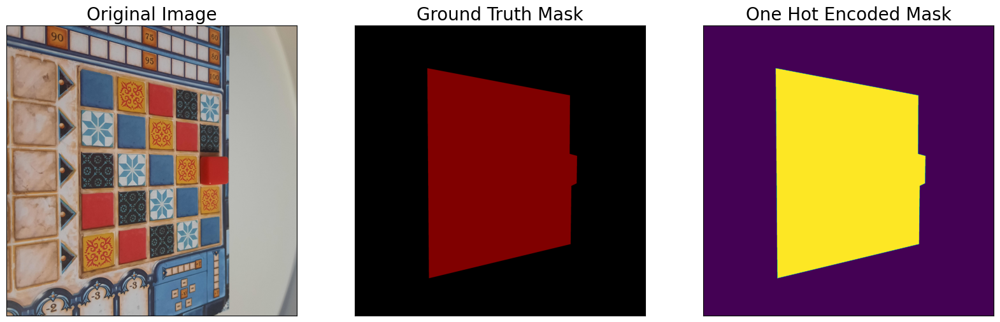

In [4]:
dataset = BEDataset(X_TRAIN_DIR, Y_TRAIN_DIR, class_rgb_values=CLASS_RGB_VALUES)
random_idx = random.randint(0, len(dataset) - 1)
image, mask = dataset[random_idx]

visualize(
    original_image=image,
    ground_truth_mask=color_code_segmentation(reverse_one_hot(mask), CLASS_RGB_VALUES),
    one_hot_encoded_mask=reverse_one_hot(mask)
)

In [5]:
training_augmentation = album.Compose([
    # album.Resize(height=IMG_SIZE, width=IMG_SIZE, always_apply=True),
    album.RandomResizedCrop(*INPUT_IMAGE_SIZE, scale=(0.25, 1.2), always_apply=True),
    album.RandomBrightness(0.2, p=0.75),
    album.OneOf([
        album.HorizontalFlip(p=1),
        album.VerticalFlip(p=1),
        album.RandomRotate90(p=1),
    ],
        p=0.75),
])

validation_augmentation = album.Compose([
    album.LongestMaxSize(max(INPUT_IMAGE_SIZE), always_apply=True),
])


def get_preprocessing(preprocessing_fn: Callable[[np.ndarray], np.ndarray] | None = None) -> album.Compose:
    def to_tensor(x: np.ndarray, **kwargs):
        _ = kwargs
        x = x.transpose(2, 0, 1).astype('float32')
        return x

    transform = []
    if preprocessing_fn:
        transform.append(album.Lambda(image=preprocessing_fn))
    transform.append(album.Lambda(image=to_tensor, mask=to_tensor))

    return album.Compose(transform)

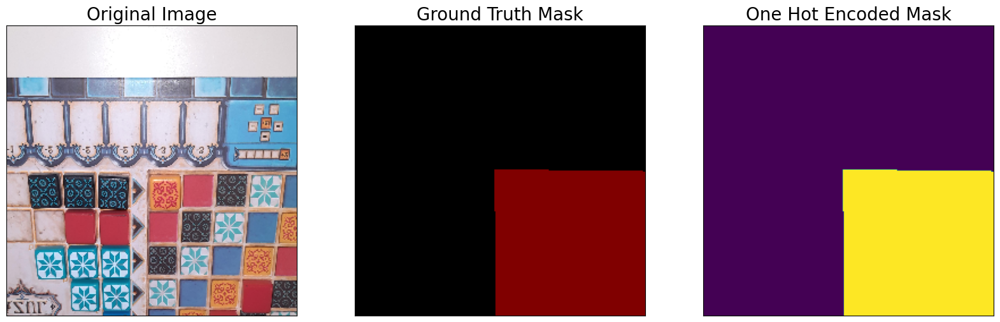

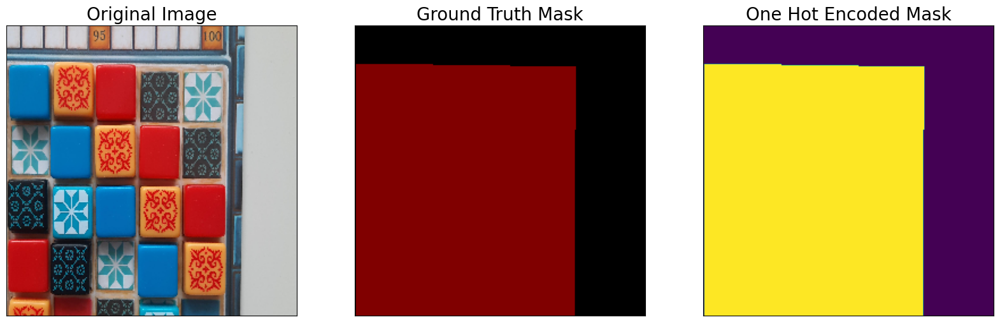

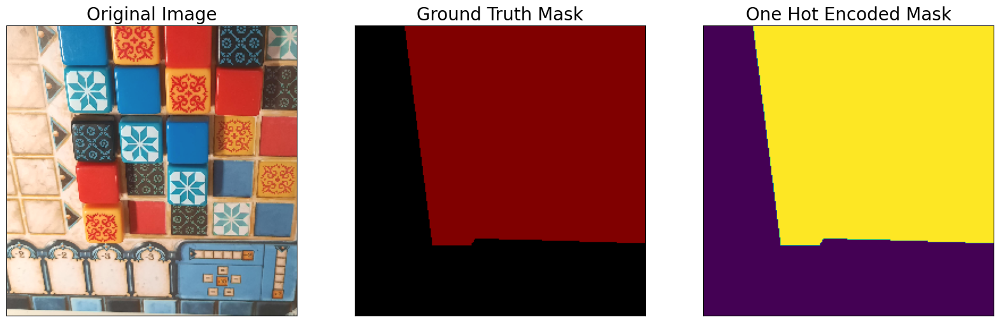

In [6]:
augmented_dataset = BEDataset(
    X_TRAIN_DIR, Y_TRAIN_DIR,
    augmentation=training_augmentation,
    class_rgb_values=CLASS_RGB_VALUES,
)

for i in range(3):
    random_idx = random.randint(0, len(augmented_dataset) - 1)
    image, mask = augmented_dataset[random_idx]
    visualize(
        original_image=image,
        ground_truth_mask=color_code_segmentation(reverse_one_hot(mask), CLASS_RGB_VALUES),
        one_hot_encoded_mask=reverse_one_hot(mask)
    )

In [7]:
train_dataset = BEDataset(
    X_TRAIN_DIR, Y_TRAIN_DIR,
    augmentation=training_augmentation,
    preprocessing=get_preprocessing(),
    class_rgb_values=CLASS_RGB_VALUES,
)

valid_dataset = BEDataset(
    X_VALID_DIR, Y_VALID_DIR,
    augmentation=validation_augmentation,
    preprocessing=get_preprocessing(),
    class_rgb_values=CLASS_RGB_VALUES,
)

train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=NUM_WORKERS, pin_memory=True)
valid_loader = DataLoader(valid_dataset, batch_size=BATCH_SIZE, shuffle=False, num_workers=NUM_WORKERS, pin_memory=True)

In [8]:
TRAINING = False

print(f"Using device: {DEVICE}")

model = UNet(
    in_channels=NUM_CHANNELS,
    n_classes=len(CLASS_NAMES),
    depth=NUM_LEVELS,
    wf=6,
    padding=True,
    batch_norm=True,
    up_mode='upsample'
)

loss = smp_utils.losses.CrossEntropyLoss()

metrics = [
    smp_utils.metrics.IoU(threshold=THRESHOLD)
]

optimizer = torch.optim.Adam(model.parameters())

scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    patience=5,
    verbose=True
)

if MODEL_WEIGHTS:
    model = torch.load(MODEL_WEIGHTS)

summary(model, input_size=(BATCH_SIZE, 3, 224, 224))

Using device: cuda


Layer (type:depth-idx)                        Output Shape              Param #
UNet                                          [6, 2, 224, 224]          --
├─ModuleList: 1-1                             --                        --
│    └─UNetConvBlock: 2-1                     [6, 64, 224, 224]         --
│    │    └─Sequential: 3-1                   [6, 64, 224, 224]         38,976
│    └─UNetConvBlock: 2-2                     [6, 128, 112, 112]        --
│    │    └─Sequential: 3-2                   [6, 128, 112, 112]        221,952
│    └─UNetConvBlock: 2-3                     [6, 256, 56, 56]          --
│    │    └─Sequential: 3-3                   [6, 256, 56, 56]          886,272
│    └─UNetConvBlock: 2-4                     [6, 512, 28, 28]          --
│    │    └─Sequential: 3-4                   [6, 512, 28, 28]          3,542,016
│    └─UNetConvBlock: 2-5                     [6, 1024, 14, 14]         --
│    │    └─Sequential: 3-5                   [6, 1024, 14, 14]         14

In [9]:
train_epoch = smp_utils.train.TrainEpoch(
    model,
    loss=loss,
    metrics=metrics,
    optimizer=optimizer,
    device=DEVICE,
    verbose=True,
)

valid_epoch = smp_utils.train.ValidEpoch(
    model,
    loss=loss,
    metrics=metrics,
    device=DEVICE,
    verbose=True,
)

In [10]:
%%time

if TRAINING:
    best_iou_score = 0.0
    train_logs_list, valid_logs_list = [], []
    counter = 0
    patience = 10

    for i in range(0, NUM_EPOCHS):
        print(f"\nEPOCH: {i}")

        train_logs = train_epoch.run(train_loader)
        valid_logs = valid_epoch.run(valid_loader)
        train_logs_list.append(train_logs)
        valid_logs_list.append(valid_logs)

        scheduler.step(valid_logs['cross_entropy_loss'])

        if best_iou_score < valid_logs['iou_score']:
            best_iou_score = valid_logs['iou_score']
            torch.save(model, MODEL_WEIGHTS)
            counter = 0
            print('Model saved!')
        else:
            counter += 1
            if counter > patience:
                break

CPU times: user 1 µs, sys: 1 µs, total: 2 µs
Wall time: 7.87 µs


In [11]:
if MODEL_WEIGHTS:
    model = torch.load(MODEL_WEIGHTS)
    print("Loaded UNet model from this run.")

Loaded UNet model from this run.


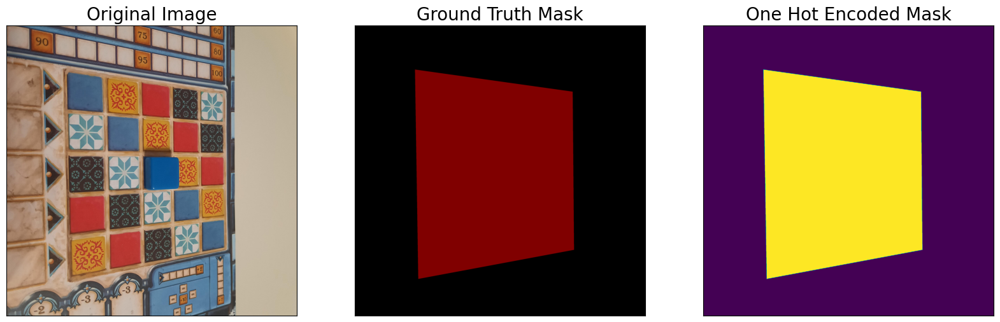

In [12]:
test_dataset = BEDataset(
    X_TEST_DIR,
    Y_TEST_DIR,
    augmentation=validation_augmentation,
    preprocessing=get_preprocessing(),
    class_rgb_values=CLASS_RGB_VALUES
)

test_dataloader = DataLoader(test_dataset)

test_dataset_vis = BEDataset(
    X_TEST_DIR,
    Y_TEST_DIR,
    # augmentation=validation_augmentation,
    class_rgb_values=CLASS_RGB_VALUES
)

random_idx = random.randint(0, len(test_dataset_vis) - 1)
image, mask = test_dataset_vis[random_idx]

visualize(
    original_image=image,
    ground_truth_mask=color_code_segmentation(reverse_one_hot(mask), CLASS_RGB_VALUES),
    one_hot_encoded_mask=reverse_one_hot(mask)
)

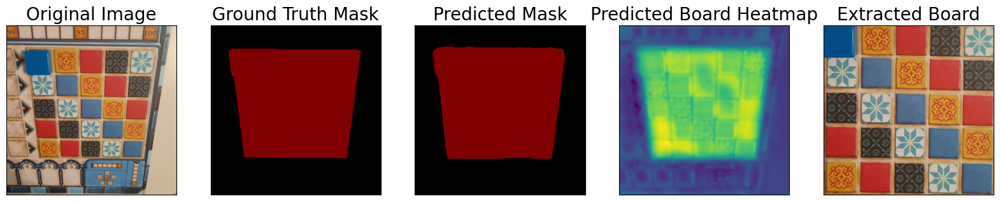

0.9638356


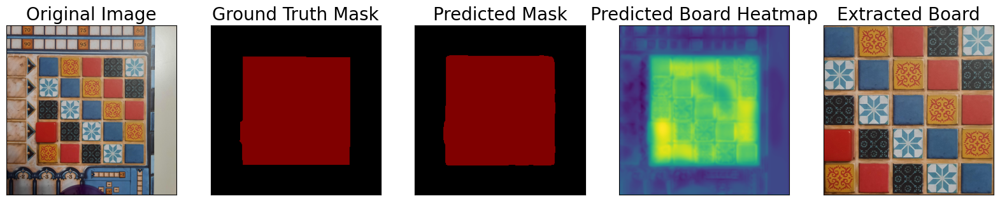

0.97502273


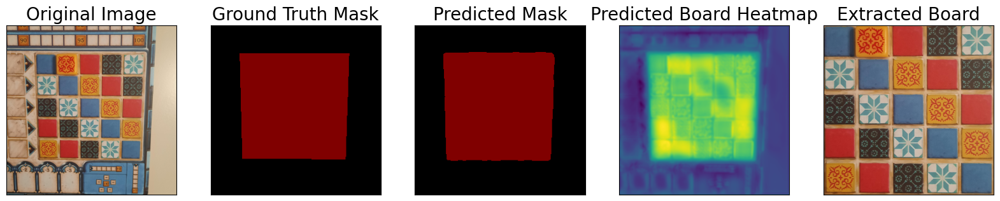

0.9678292


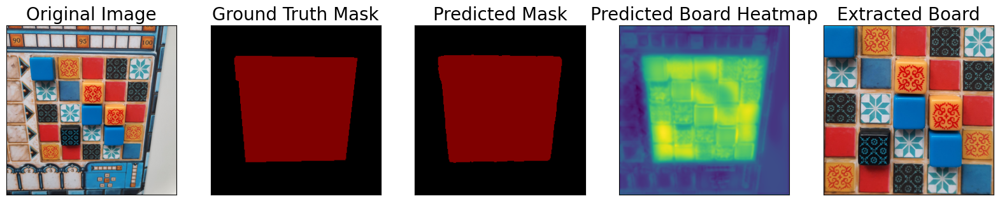

0.97643185


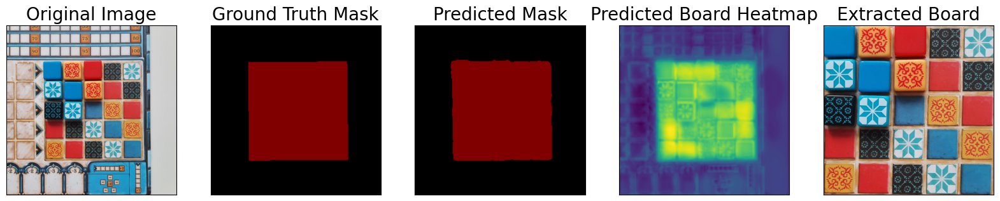

0.9834234


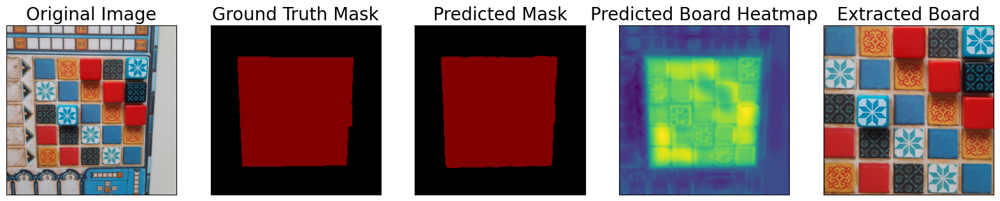

0.979084


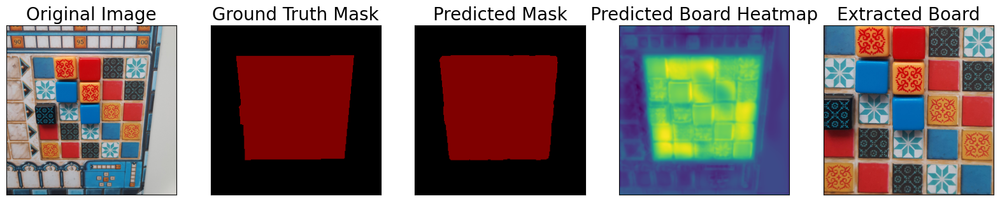

0.9803307


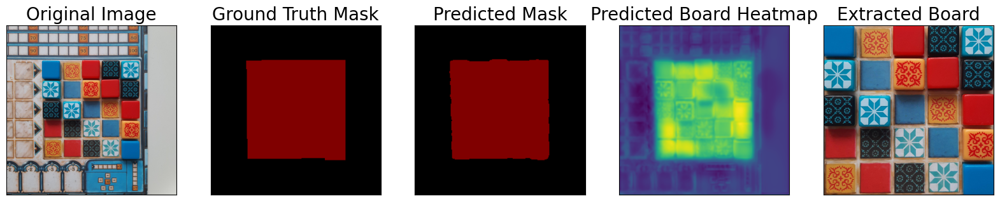

0.98423576


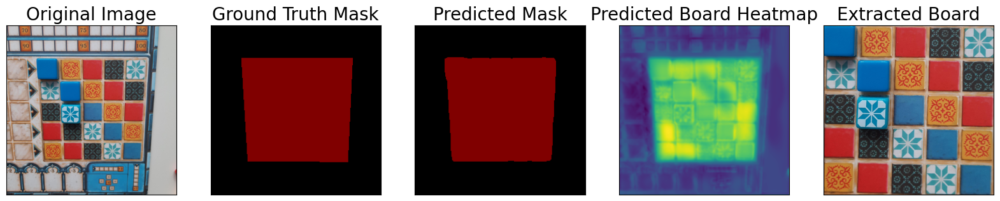

0.984111


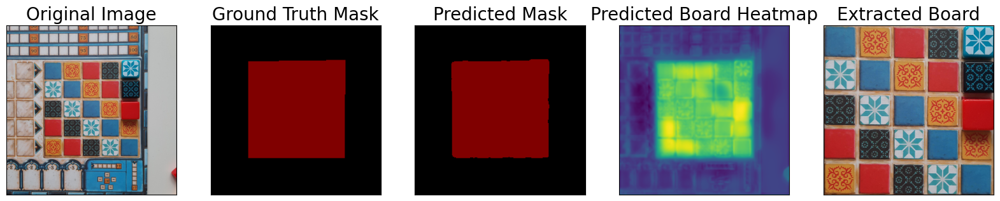

0.9890762


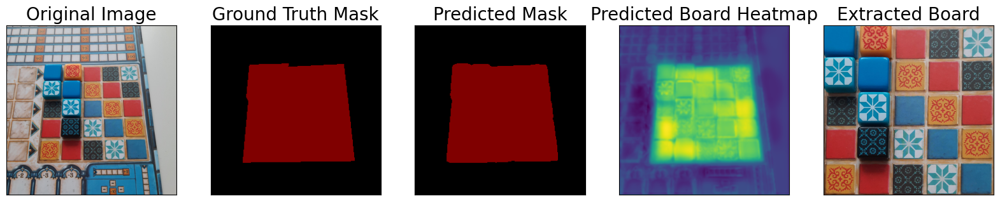

0.9842269


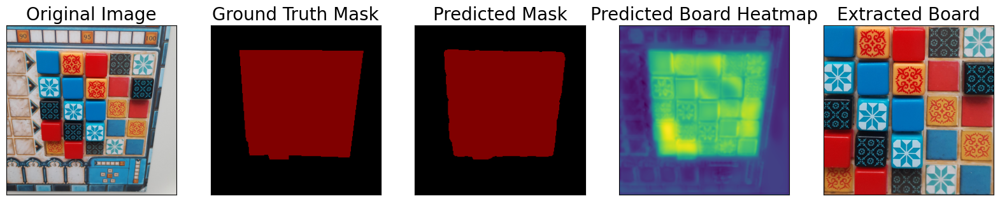

0.9790869


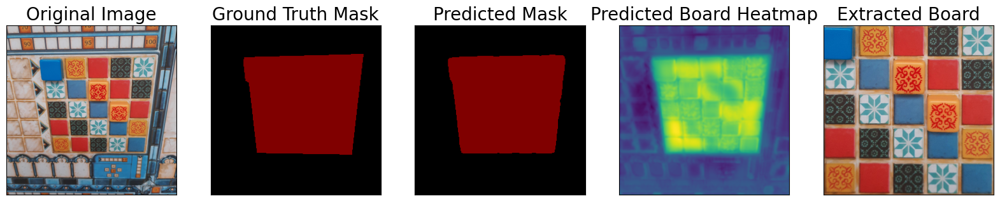

0.9791641


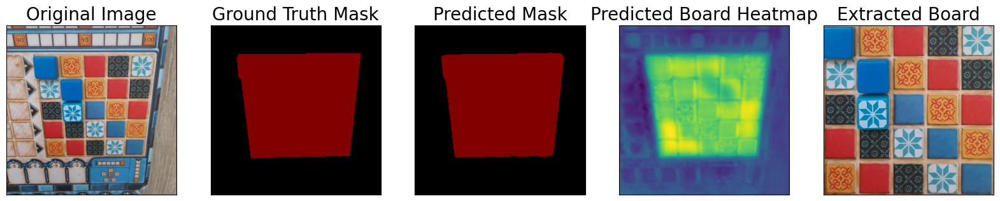

0.9845579


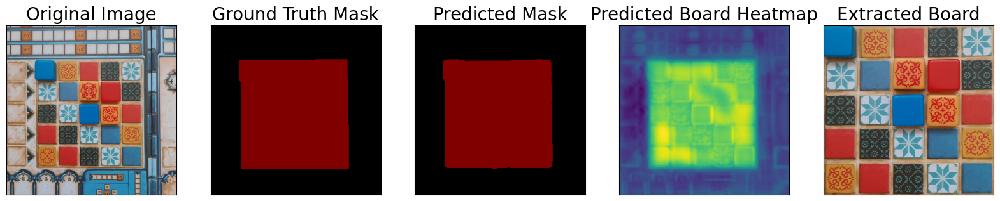

0.9849076


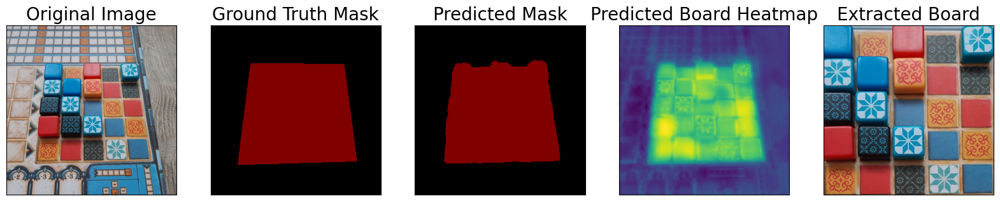

0.96636397


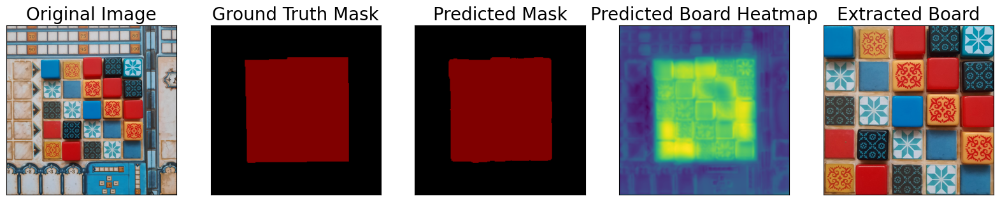

0.982076


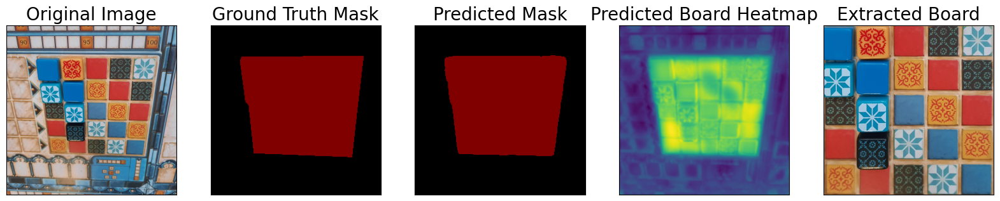

0.9797892


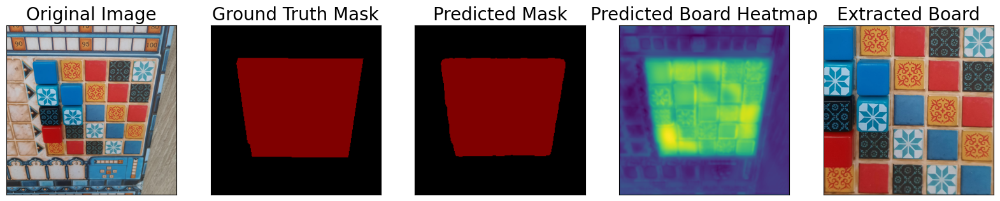

0.97608024


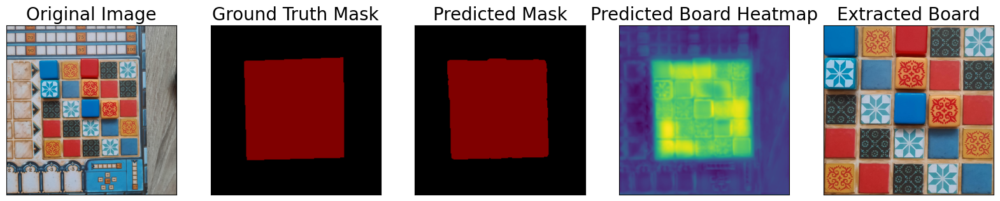

0.980754


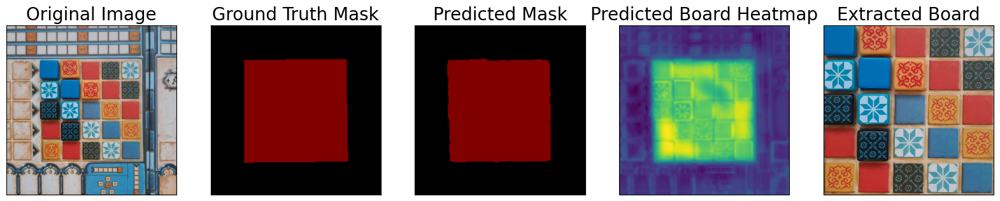

0.9800456


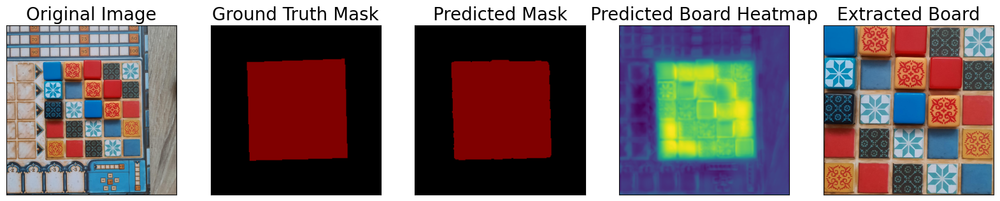

0.9815124


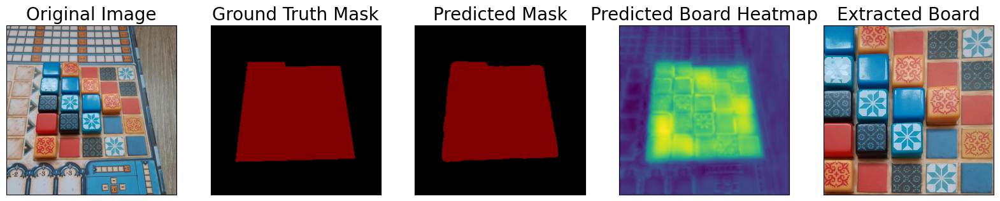

0.9781634


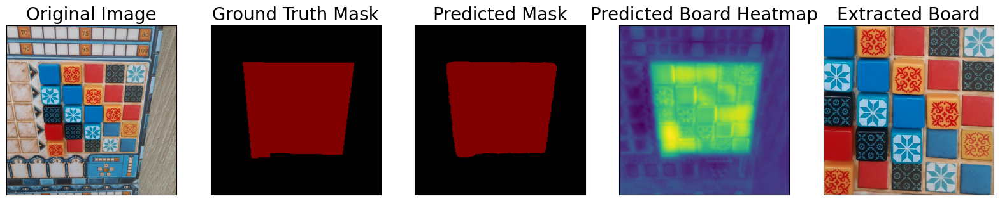

0.98024106


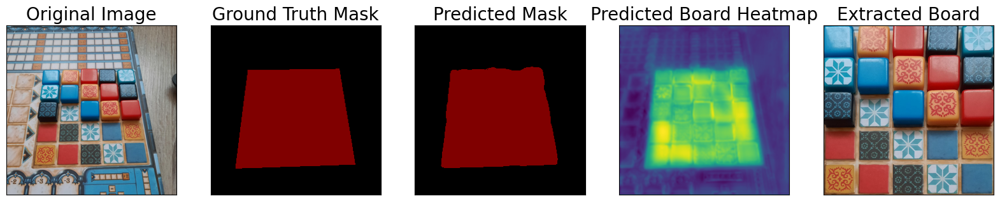

0.97589904


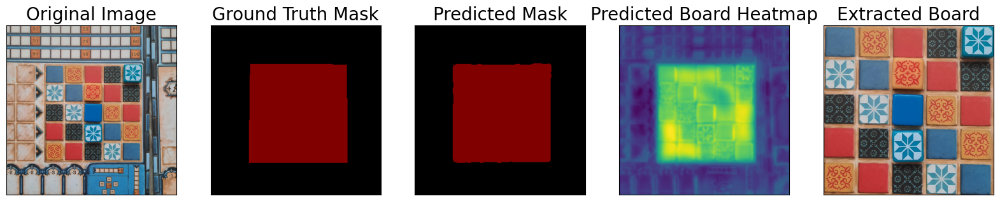

0.9880909


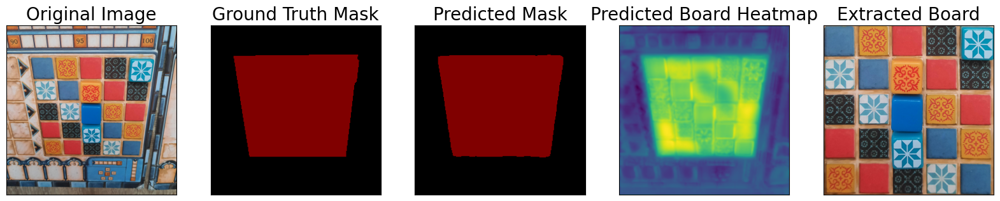

0.98291326


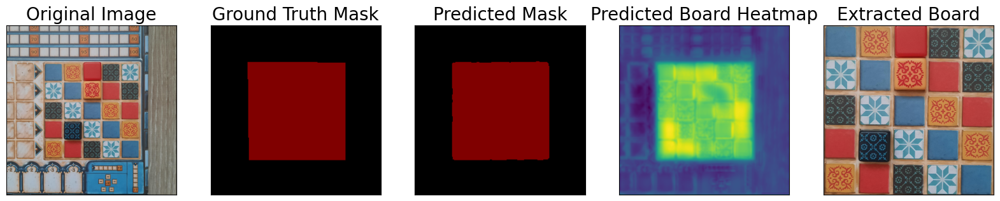

0.9879206


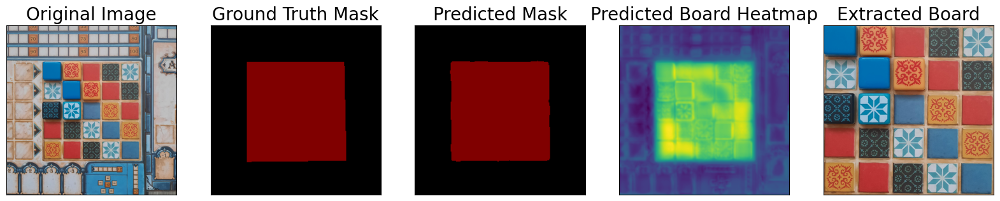

0.98649246


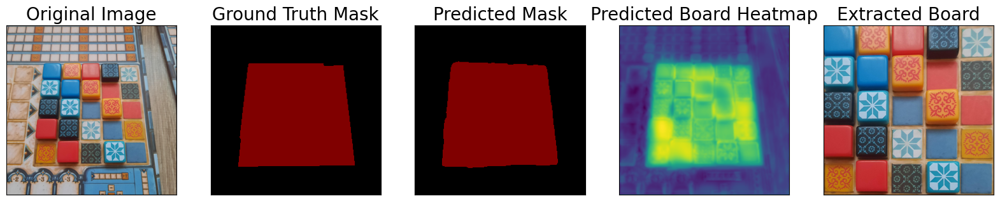

0.97956544


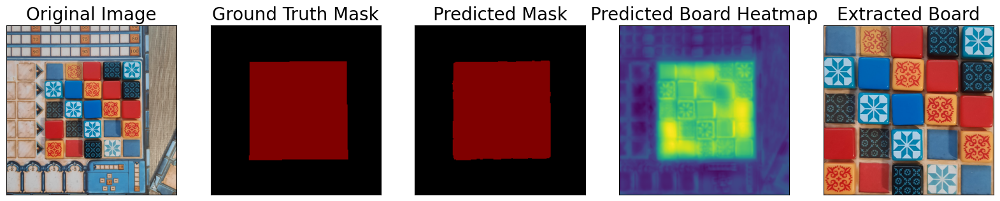

0.9844252


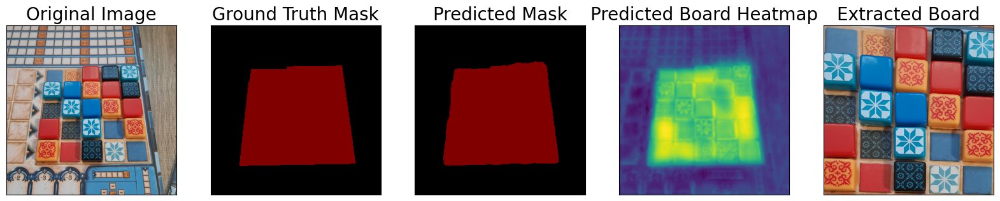

0.97792745


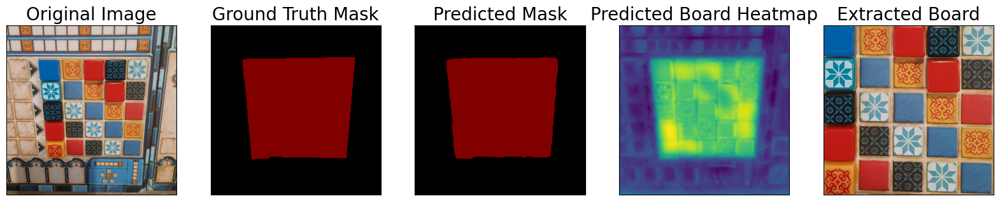

0.985427


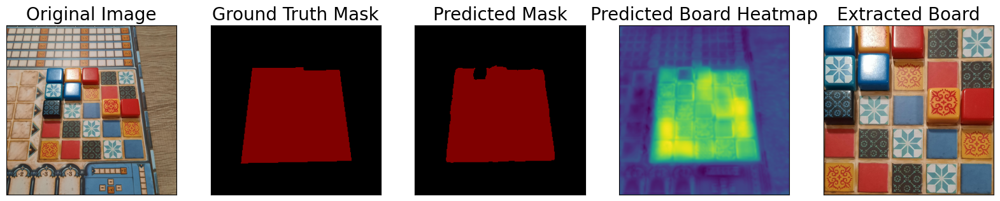

0.97629684


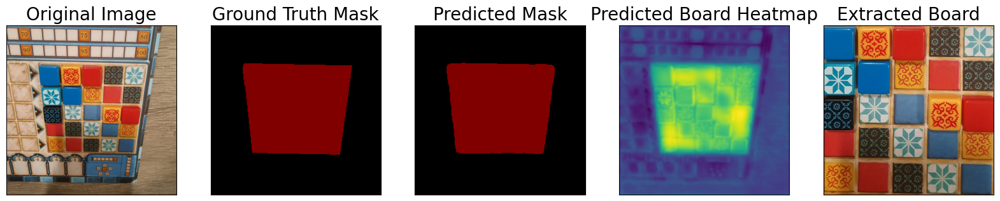

0.9846906


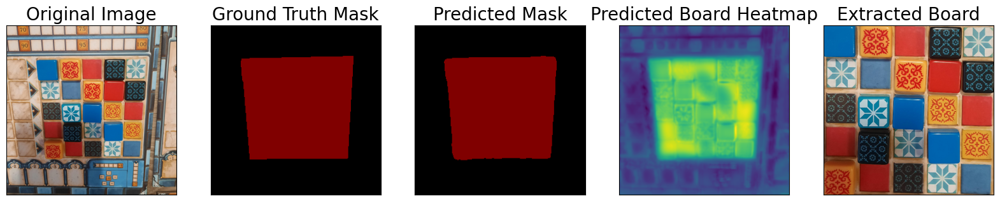

0.9847575


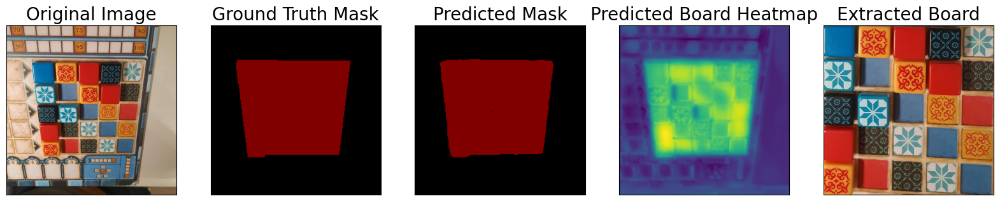

0.98319215


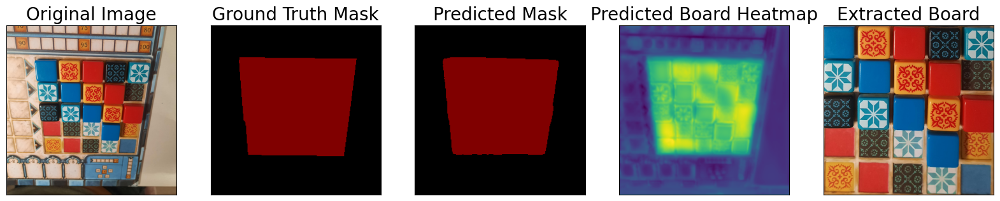

0.9729128


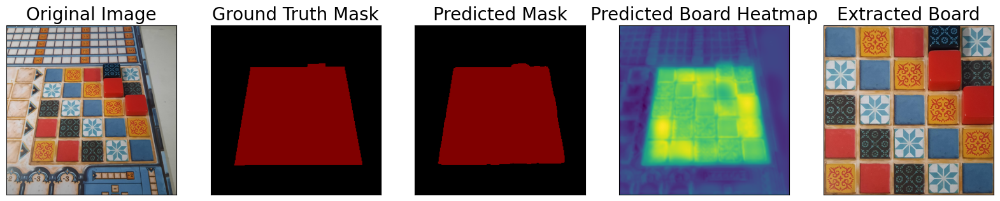

0.9812504


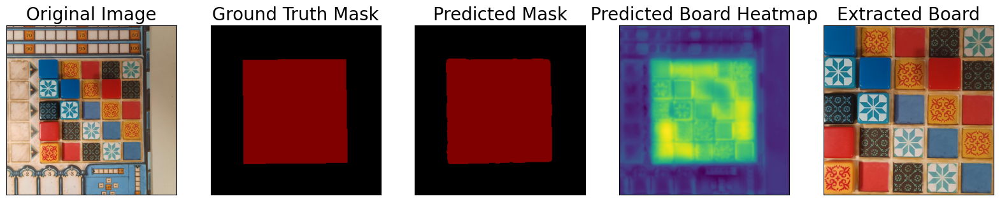

0.98288727


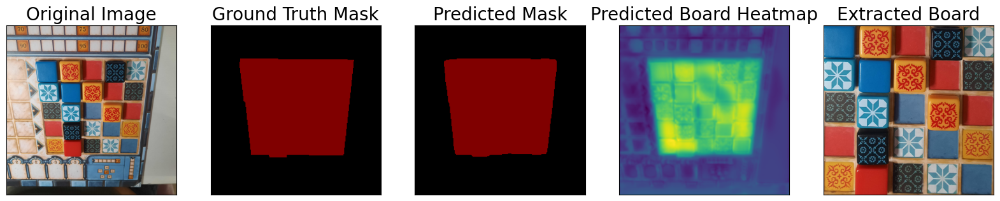

0.98452044


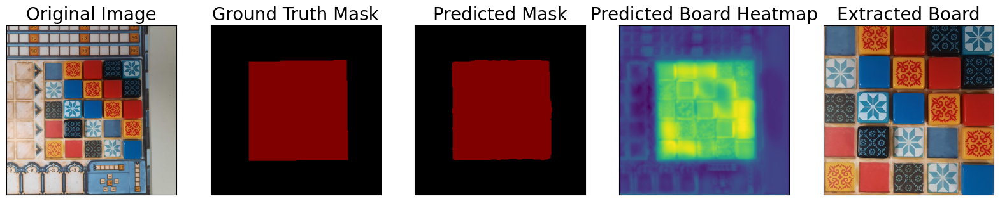

0.98336935


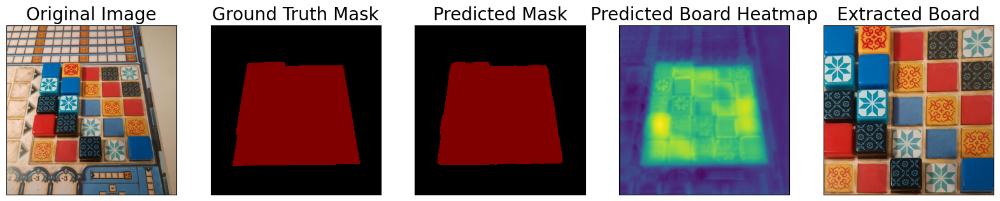

0.9833018


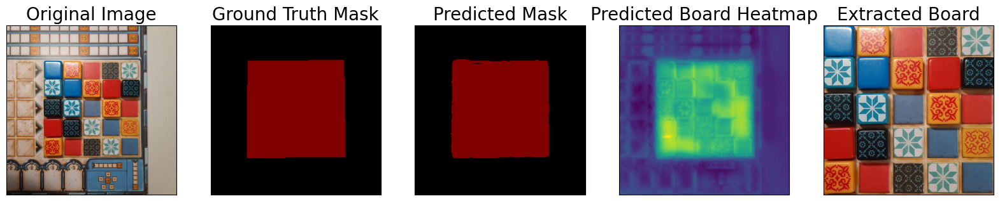

0.9846857


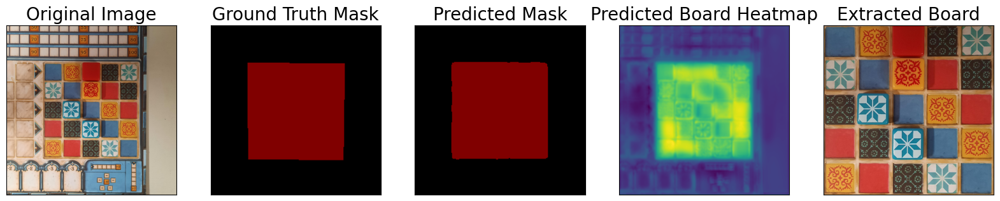

0.9830351


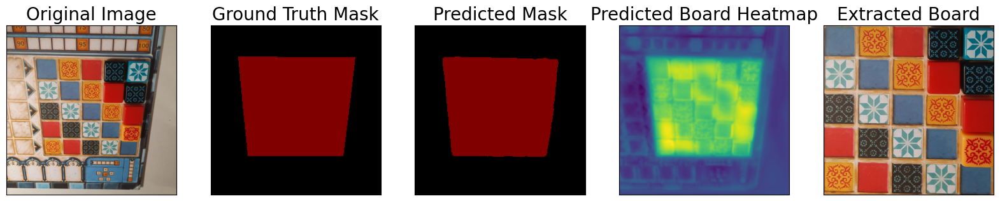

0.9841611


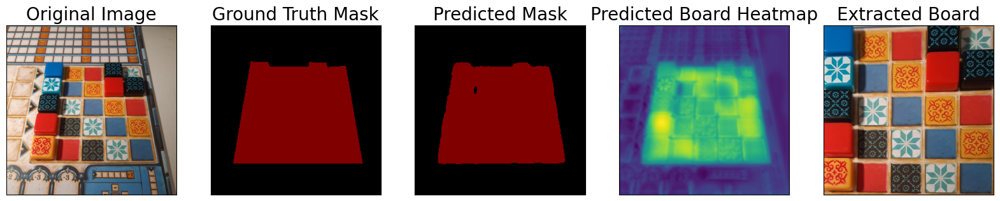

0.98114556


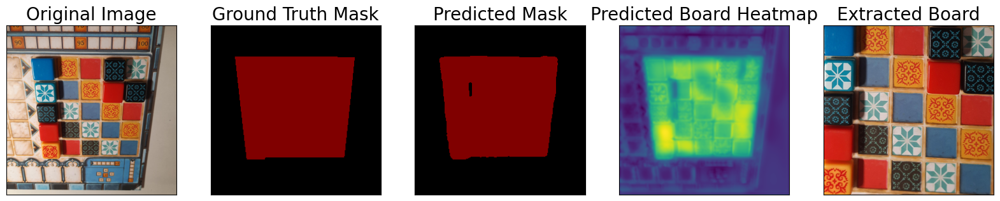

0.9810171


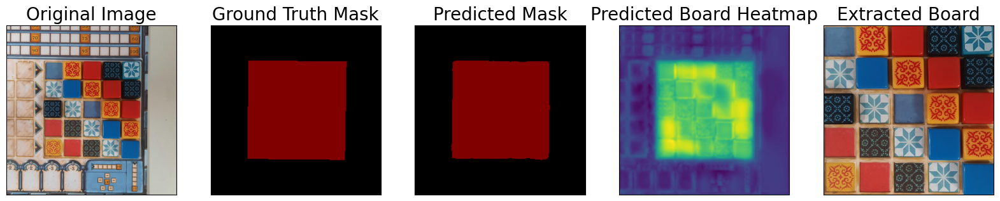

0.9862534


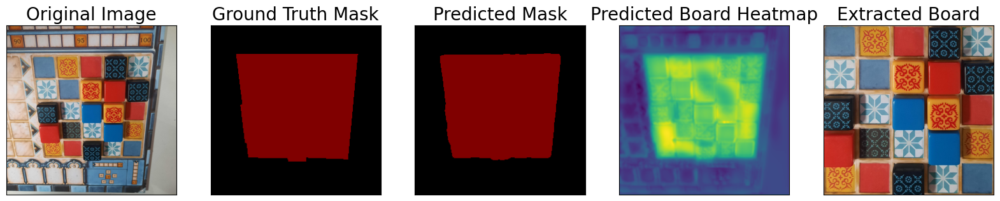

0.98231906


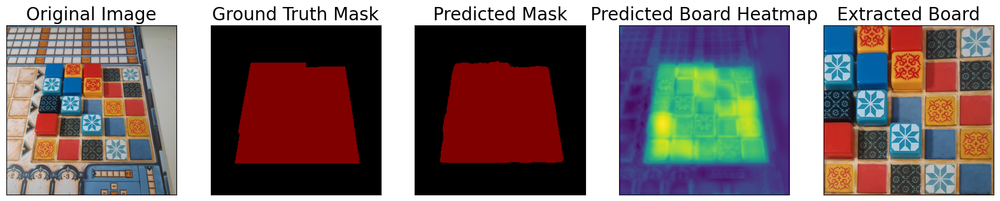

0.9823196


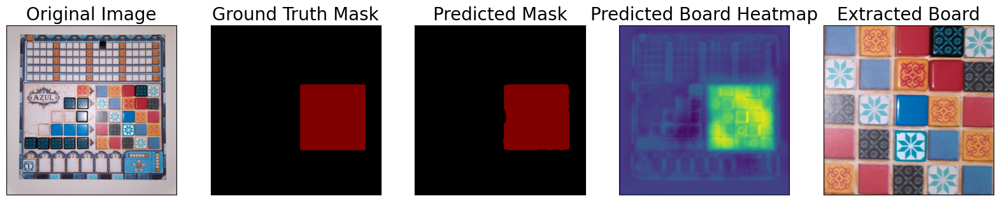

0.99165726


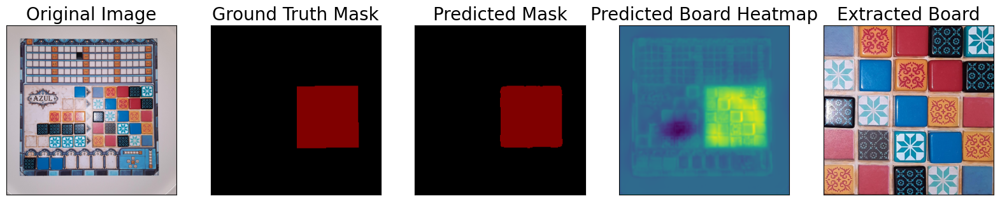

0.99147296


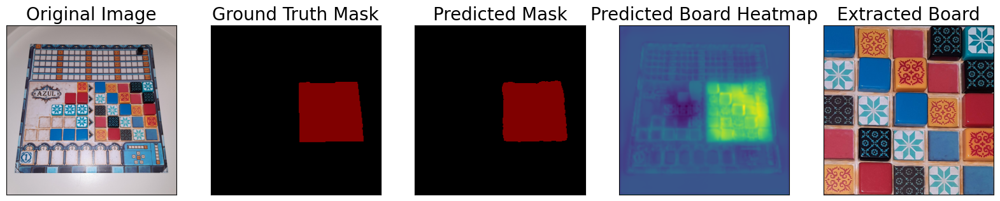

0.9908475


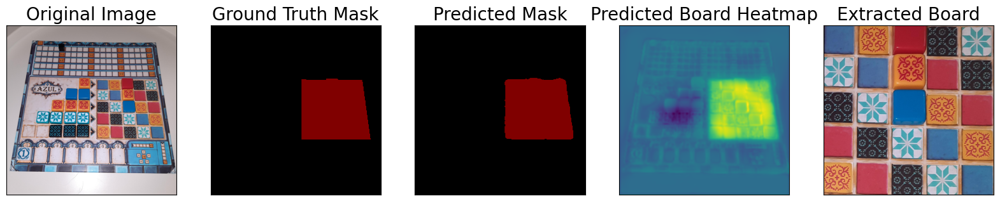

0.99040896


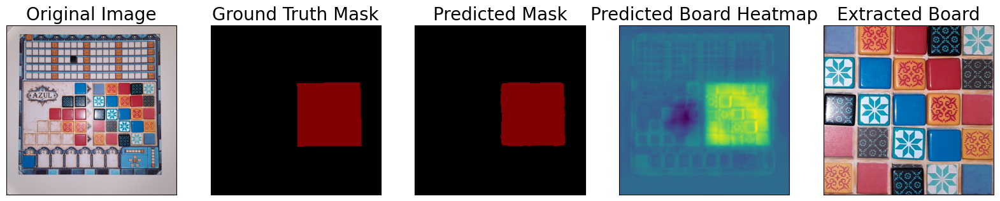

0.9914599


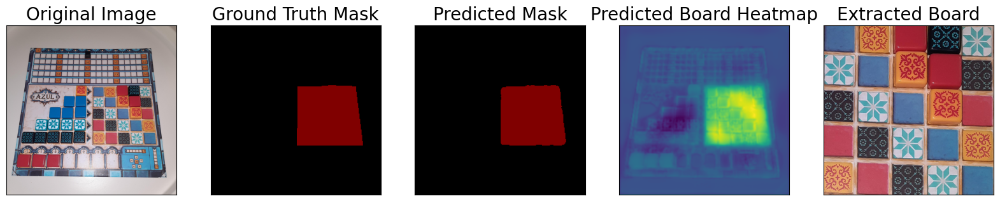

0.99062073


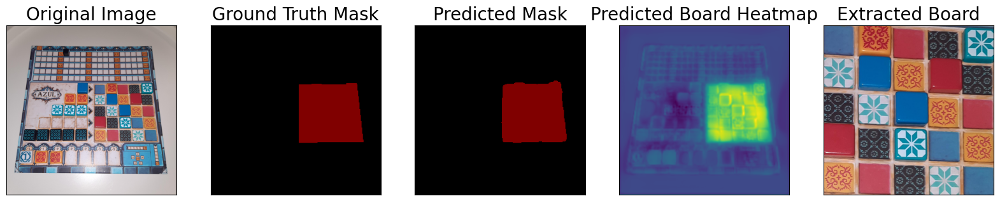

0.98951346


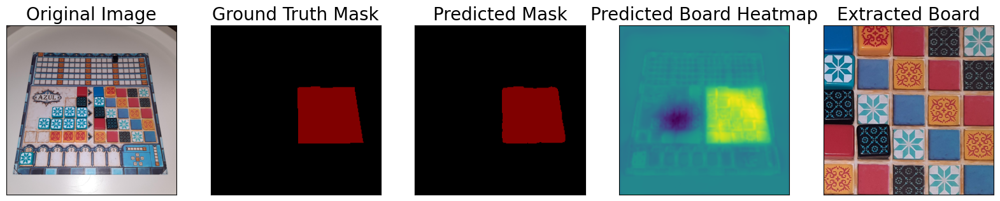

0.9902575


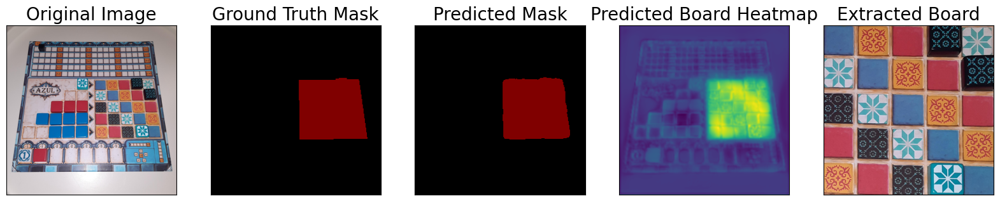

0.9896796


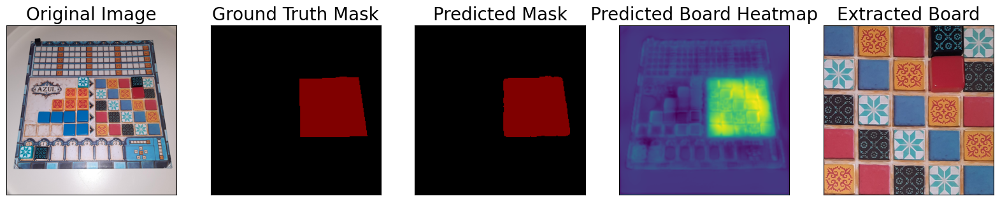

0.99050105


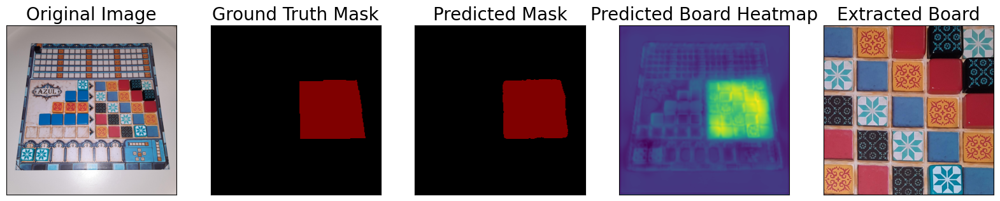

0.9878866


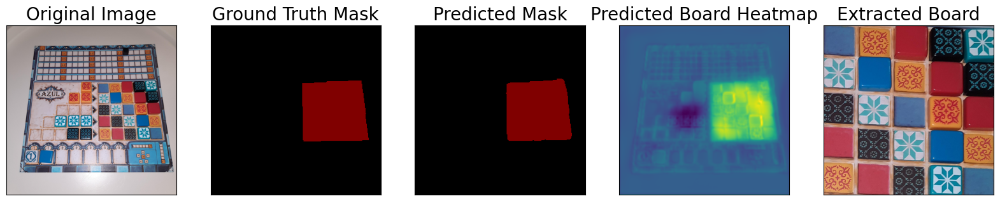

0.99048305


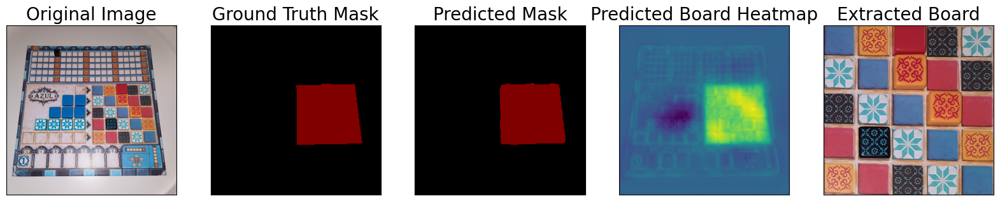

0.9904233


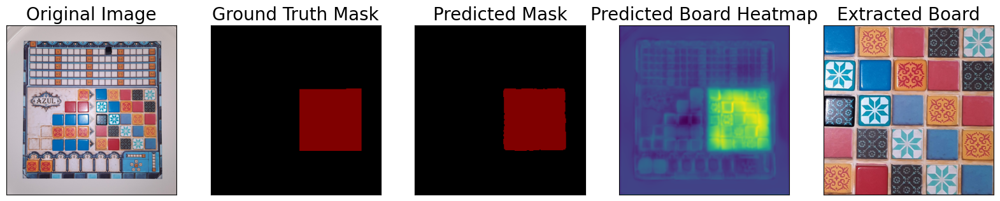

0.9905775


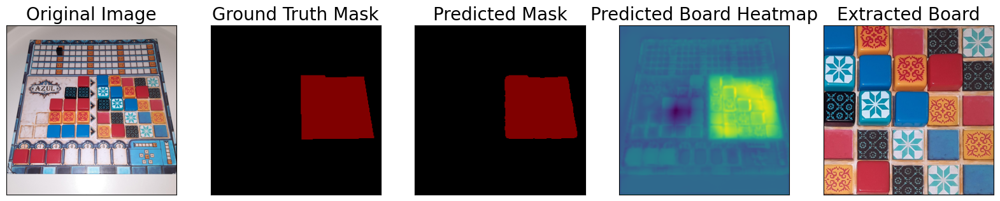

0.9909389


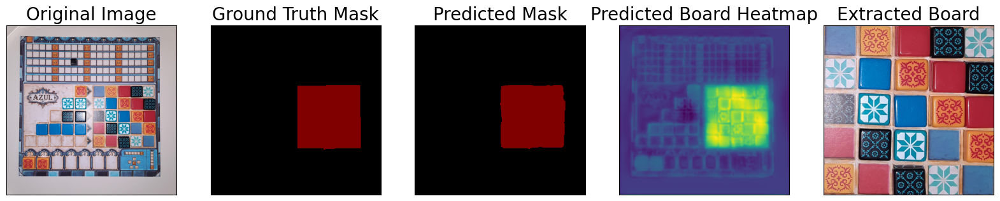

0.9885695


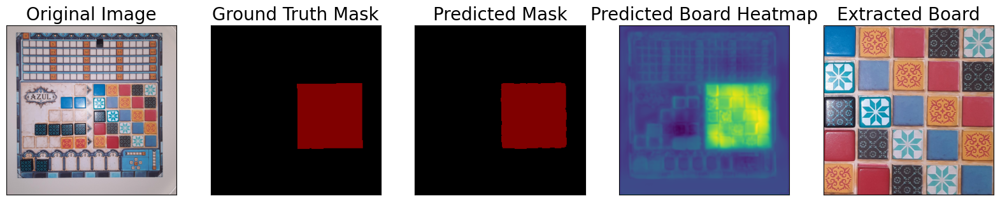

0.99183804


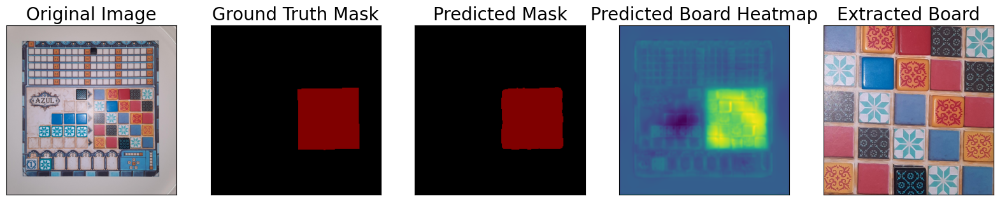

0.99092364


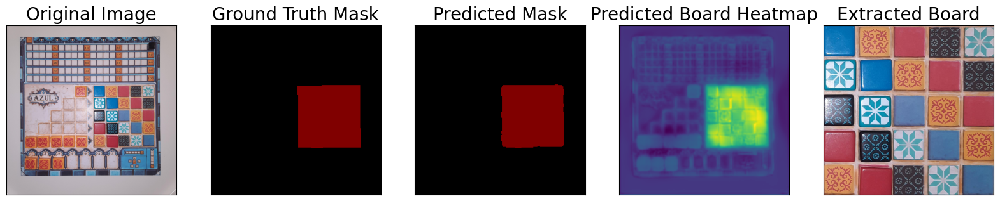

0.9911692


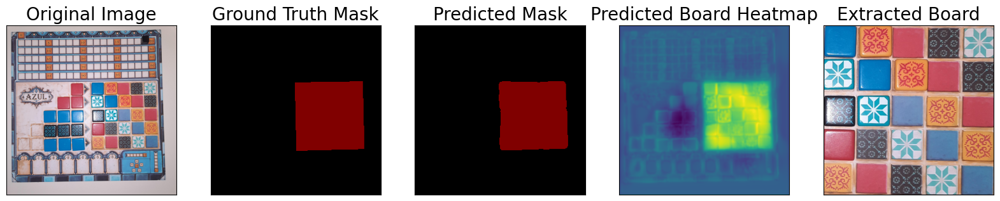

0.9897418


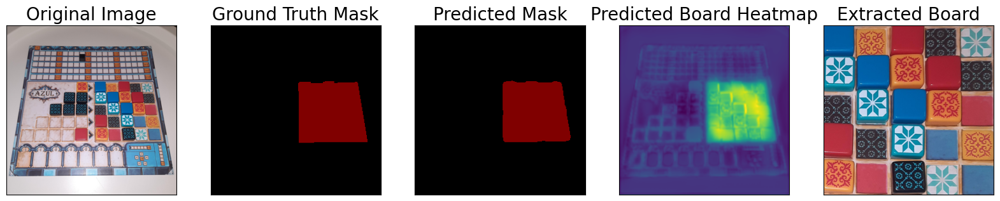

0.9895292


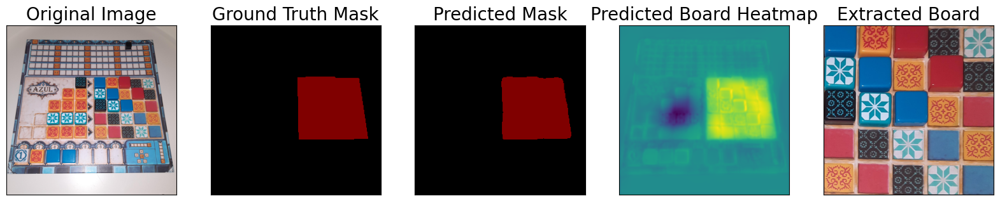

0.9914586


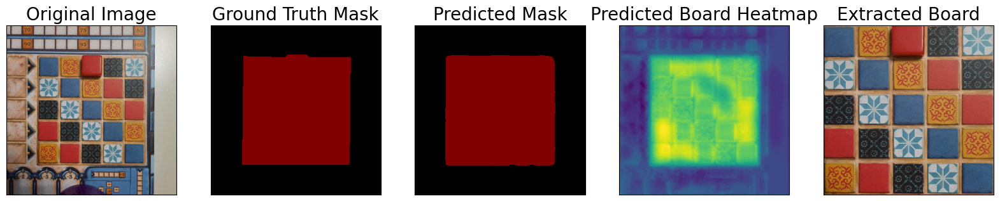

0.97254336


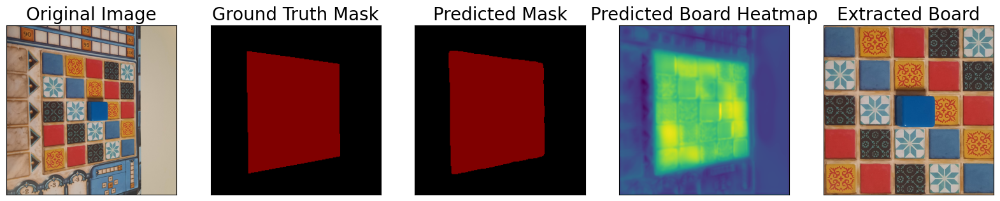

0.97192353


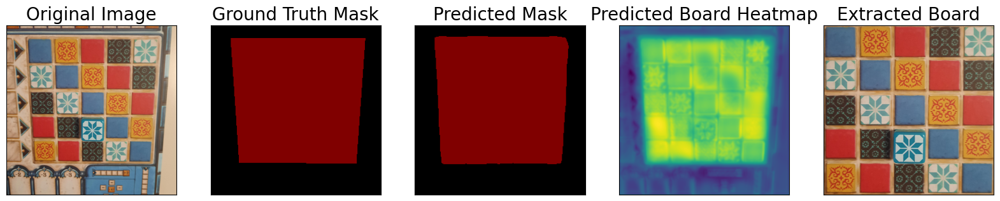

0.9610368


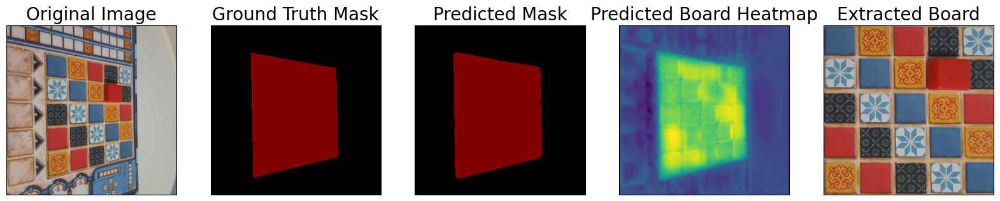

0.9734525


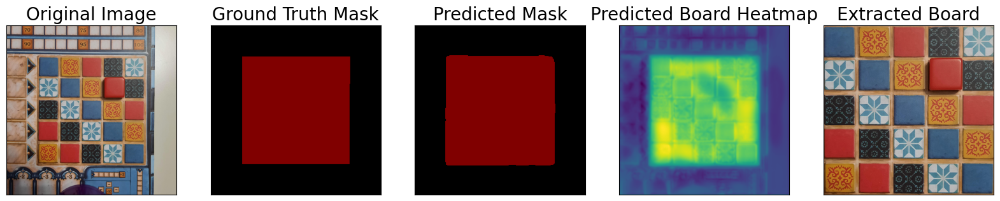

0.9716614


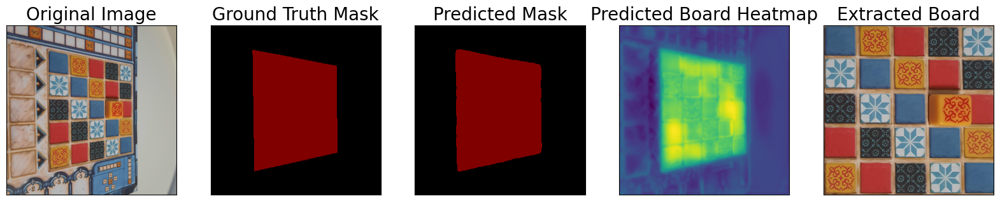

0.97854245


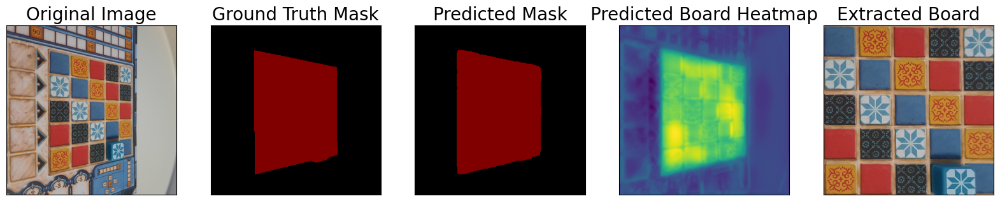

0.97469294
Mean IoU: 0.9828117489814758


In [19]:
from segmentation_models_pytorch.utils.functional import iou
from azulvision.board_extraction.extract import scale_approx

iou_sum = 0

model.eval()
for idx in range(len(test_dataset)):
    image, gt_mask = test_dataset[idx]
    image_vis = test_dataset_vis[idx][0].astype('uint8')
    x_tensor = torch.from_numpy(image).to(DEVICE).unsqueeze(0)
    # Predict test image
    pred_mask = model(x_tensor)

    _iou = iou(pred_mask.squeeze(), torch.from_numpy(gt_mask).to(DEVICE), eps=1e-7, threshold=0.5)

    pred_mask = pred_mask.detach().squeeze().cpu().numpy()
    # Convert pred_mask from `CHW` format to `HWC` format
    pred_mask = np.transpose(pred_mask, (1, 2, 0))
    # Get prediction channel corresponding to building
    pred_building_heatmap = pred_mask[:, :, CLASS_NAMES.index('board')]
    for_contour = reverse_one_hot(pred_mask)

    pred_mask = color_code_segmentation(reverse_one_hot(pred_mask), CLASS_RGB_VALUES)
    # Convert gt_mask from `CHW` format to `HWC` format
    gt_mask = np.transpose(gt_mask, (1, 2, 0))
    gt_mask = color_code_segmentation(reverse_one_hot(gt_mask), CLASS_RGB_VALUES)

    contours = cv2.findContours(fix_mask(for_contour, threshold=0.5), cv2.RETR_LIST, cv2.CHAIN_APPROX_SIMPLE)
    contours = imutils.grab_contours(contours)

    if len(contours) > 1:
        contours = ignore_contours(pred_mask.shape, contours)

    approx = None
    if len(contours) > 0:
        for i in range(len(contours)):
            cnt = contours[i]
            arclen = cv2.arcLength(cnt, True)
            candidate = cv2.approxPolyDP(cnt, 0.1 * arclen, True)

            if len(candidate) != 4:
                continue

            approx = rotate_quadrangle(candidate)
            break

    if approx is not None:
        approx = scale_approx(approx, image_vis.shape)
        board = extract_perspective(image_vis, approx, BOARD_IMAGE_SIZE)
        board = cv2.flip(board, 1)
        # board = cv2.cvtColor(board, cv2.COLOR_RGB2GRAY)
        visualize(
            original_image=image_vis,
            ground_truth_mask=gt_mask,
            predicted_mask=pred_mask,
            predicted_board_heatmap=pred_building_heatmap,
            extracted_board=board
        )
    else:
        visualize(
            original_image=image_vis,
            ground_truth_mask=gt_mask,
            predicted_mask=pred_mask,
            predicted_board_heatmap=pred_building_heatmap
        )

    print(_iou.detach().cpu().numpy())
    iou_sum += _iou

    del x_tensor

print(f"Mean IoU: {iou_sum / len(test_dataset)}")